<a href="https://colab.research.google.com/github/DiogoCarapito/predictive_methods_project_nova_ims/blob/main/202223_PMDM_Group11_Notebook.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# 202223 PMDM Group11 Notebook


### Lista de tarefas
1. **Businness needs**
  - [x] Entender o problema  
2. **Data Integration**
  - [x] Importações e instalações
  - [x] Conectar datasets a partir do google drive
  - [x] Upload dos dados
3. **Data Acess, Exploration and Understanding**
  - [x] Fazer data profiling
  - [ ] Fazer visualizações
  - [ ] Indetificar outliers
  - [ ] Indetificar missing values
  - [ ] Fazer um  pipeline
4. **Data Preparation**
  - [ ] Testar vários modelos
  - [ ] Feature engeneering
  - [ ] Feature selection  
5. **Modeling**
  - [ ] 
6. **Acessement**
  - [ ] 
7. **Deployment**
  - [ ] 
8. **Relatório ?**
  - [ ] 


# 1. Businness needs

Objectivo: Construir um modelo que consiga establecer previsão resultado da competição (OUTCOME > Competition result) com base em dados sociais, performance desportiva, infomração clínica do atleta.


# 2. Data integration

In [ ]:
# Install updated version of pandas_profiling.
!pip install pandas_profiling==3.3.0

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 268.0/268.0 KB 16.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 33.8/33.8 MB 40.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 11.2/11.2 MB 94.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 78.5/78.5 KB 11.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 102.7/102.7 KB 13.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 292.8/292.8 KB 33.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 12.4/12.4 MB 79.5 MB/s eta 0:00:00
  Attempting uninstall: tqdm
    Found existing installation: tqdm 4.65.0
    Uninstalling tqdm-4.65.0:
      Successfully uninstalled tqdm-4.65.0
  Attempting uninstall: scipy
    Found existing installation: scipy 1.10.1
    Uninstalling scipy-1.10.1:
      Successfully uninstalled scipy-1.10.1
  Attempting uninstall: pydantic
   

In [ ]:
# Connect Google Colab to Drive
from google.colab import drive
drive.mount('/content/drive', force_remount=True)

path = '/content/drive/MyDrive/Colab Notebooks/PMDM/Project/Datasets/'

Mounted at /content/drive


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from math import ceil

from itertools import product
from pandas_profiling import ProfileReport

In [ ]:
df_train = pd.read_csv(path + 'train.csv')
df_test = pd.read_csv(path + 'test.csv')

# 3. Data Acess, Exploration and Understanding

In [ ]:
df_train.head(5)

,RecordID,Competition,Edition,Athlete Id,Sex,Region,Education,Age group,Income,Disability,...,Cardiovascular training,Outdoor Workout,Squad training,Physiotherapy,Plyometric training,No coach,Sport-specific training,Other training,Past injuries,Outcome
0,44141,Federation League,2019.0,549337.0,M,Southern Africa,High school,0-35,Middle,False,...,0.0,False,7.0,0.0,0.0,False,1.0,0.0,False,0
1,78417,Regional Tournament,2021.0,631492.0,F,Oceania,University Degree,0-35,Low,False,...,118.0,False,0.0,0.0,0.0,False,65.0,0.0,False,1
2,63424,Olympic Games,2022.0,2168833.0,M,Middle East,Middle school,35-55,Middle,False,...,0.0,False,0.0,0.0,0.0,False,0.0,0.0,False,0
3,72391,National Cup,2021.0,573153.0,M,Southern Europe,Middle school,0-35,Low,False,...,55.0,False,0.0,0.0,0.0,False,3.0,0.0,False,0
4,46699,Local Match,2019.0,606079.0,M,Southern Europe,High school,35-55,Middle,False,...,265.0,False,22.0,50.0,13.0,False,25.0,0.0,False,0



**Variable > Description**

**Athlete Id** > ID

**Age group** > Athlete age range 

**Athlete score** > Athlete score from previous competitions

**Cancelled enrollment** > Athlete cancelled the competition enrollment 

**Cardiovascular training** > Number of training sessions such as running, cycling, or swimming

**Competition** > Type of competition

**Disability** > Athlete with disability 

**Edition** > 
  The year of the edition competition

**Education** >  Athlete education level 

**Income** > Athlete income level

**Late enrollment** > Athlete enrolled in the competition belatedly 

**Mental preparation** > Athlete has developed strategies for handling with stress and pressure

**No coach** > Athlete does not have a coach

**Other training** > Number of training sessions using non-standard approaches

**OUTCOME** > Competition result (TARGET)

**Outdoor workout** > Training conducted outdoors in parks or forests

**Past injuries** > Athlete had sport injuries

**Physiotherapy** > Number of physiotherapy sessions

**Plyometric training** > Number of training sessions involving explosive, high-intensity movements

**Previous attempts** > Number of previous competitions attempts

**RecordID** > ID of the registration of one athlete into an edition of a given competition

**Recover** > Number of recovery sessions using stretching and massages techniques

**Region** > Athlete region

**Sand training** > Number of training sessions  involving sand drills

**Sex** > Athlete sex

**Sport-specific training** > Number of training sessions that mimic competition scenarios

**Squad training** > Number of training sessions that involve a group of athletes working together to prepare for competition

**Strength training** > Number of training sessions using weightlifting and bodyweight exercises

**Supplements** > Number of nutritional supplements taken to aid performance

**Train bf competition** > Number of pre-competition preparation sessions

In [ ]:
df_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 18055 entries, 0 to 18054
Data columns (total 30 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   RecordID                 18055 non-null  int64  
 1   Competition              17968 non-null  object 
 2   Edition                  17959 non-null  float64
 3   Athlete Id               17965 non-null  float64
 4   Sex                      17962 non-null  object 
 5   Region                   17953 non-null  object 
 6   Education                17960 non-null  object 
 7   Age group                17952 non-null  object 
 8   Income                   17965 non-null  object 
 9   Disability               17966 non-null  object 
 10  Previous attempts        17968 non-null  float64
 11  Late enrollment          17969 non-null  object 
 12  Cancelled enrollment     17967 non-null  object 
 13  Athlete score            17968 non-null  float64
 14  Mental preparation    

In [ ]:
## Tipos de dados
df_train.dtypes

RecordID                     int64
Competition                 object
Edition                    float64
Athlete Id                 float64
Sex                         object
Region                      object
Education                   object
Age group                   object
Income                      object
Disability                  object
Previous attempts          float64
Late enrollment             object
Cancelled enrollment        object
Athlete score              float64
Mental preparation          object
Train bf competition       float64
Strength training          float64
Sand training              float64
Recovery                   float64
Supplements                float64
Cardiovascular training    float64
Outdoor Workout             object
Squad training             float64
Physiotherapy              float64
Plyometric training        float64
No coach                    object
Sport-specific training    float64
Other training             float64
Past injuries       

In [ ]:
## Contagem de missing values
df_train.isna().sum()

RecordID                     0
Competition                 87
Edition                     96
Athlete Id                  90
Sex                         93
Region                     102
Education                   95
Age group                  103
Income                      90
Disability                  89
Previous attempts           87
Late enrollment             86
Cancelled enrollment        88
Athlete score               87
Mental preparation          77
Train bf competition        96
Strength training           78
Sand training               79
Recovery                    95
Supplements                 90
Cardiovascular training     94
Outdoor Workout             84
Squad training              89
Physiotherapy               90
Plyometric training         66
No coach                    84
Sport-specific training     96
Other training             101
Past injuries              105
Outcome                      0
dtype: int64

In [ ]:
# percentagem de missing data em cada uma das variáveis
round(df_train.isna().sum()/len(df_train)*100, 3).apply(lambda x: '{:.3f}%'.format(x))

#os unicos que não têm falra de dados são o recordID e o Outcome...
# muito trabalhinho a tratar esta porra =P
# pensamento: talvez um metodo tipo fill with mean/mode ou um k-nearest neighbour...

RecordID                   0.000%
Competition                0.482%
Edition                    0.532%
Athlete Id                 0.498%
Sex                        0.515%
Region                     0.565%
Education                  0.526%
Age group                  0.570%
Income                     0.498%
Disability                 0.493%
Previous attempts          0.482%
Late enrollment            0.476%
Cancelled enrollment       0.487%
Athlete score              0.482%
Mental preparation         0.426%
Train bf competition       0.532%
Strength training          0.432%
Sand training              0.438%
Recovery                   0.526%
Supplements                0.498%
Cardiovascular training    0.521%
Outdoor Workout            0.465%
Squad training             0.493%
Physiotherapy              0.498%
Plyometric training        0.366%
No coach                   0.465%
Sport-specific training    0.532%
Other training             0.559%
Past injuries              0.582%
Outcome       

In [ ]:
# Missing Values

print(f"Total de dados: {df_train.shape[0]}")
print(f"Total de dados sem missing values: {df_train.dropna().shape[0]}")
print(f"Percentagem de dados removidos: {round(100*(1-df_train.dropna().shape[0]/df_train.shape[0]),2)}%")

# não dá para remover tudo...
# vamos ter que gerir introduzir novos dados

Total de dados: 18055
Total de dados sem missing values: 15691
Percentagem de dados removidos: 13.09%


In [ ]:
## Cerificar Diplicados
df_train.duplicated().sum()

0

# Variáveis Numéricas

In [ ]:
## Descrição estatística descritiva - Numerical
df_train.describe().T 

,count,mean,std,min,25%,50%,75%,max
RecordID,18055.0,55010.086846,26018.144281,10001.0,32344.5,54875.0,77466.5,99990.0
Edition,17959.0,2020.651317,1.209453,2019.0,2019.0,2021.0,2022.0,2022.0
Athlete Id,17965.0,703745.186863,550245.183498,8462.0,503183.0,588146.0,642591.0,2698588.0
Previous attempts,17968.0,0.154831,0.465858,0.0,0.0,0.0,0.0,6.0
Athlete score,17968.0,16.543856,36.215332,-30.0,0.0,0.0,30.0,140.0
Train bf competition,17959.0,266.042764,323.645815,0.0,80.0,171.0,335.0,5012.0
Strength training,17977.0,476.577516,699.269019,0.0,62.0,202.0,584.0,9438.0
Sand training,17976.0,3.405096,36.108953,0.0,0.0,0.0,0.0,2480.0
Recovery,17960.0,305.545490,622.102598,0.0,31.0,121.0,327.0,10483.0
Supplements,17965.0,133.868466,174.275943,0.0,24.0,66.0,181.0,4345.0


In [ ]:
# lista de variáveis numéricas
metric_features = ['Edition', 'Previous attempts','Athlete score', 'Train bf competition', 'Strength training', 'Sand training', 'Recovery', 'Supplements', 'Cardiovascular training', 'Squad training', 'Physiotherapy', 'Plyometric training', 'Sport-specific training', 'Other training']

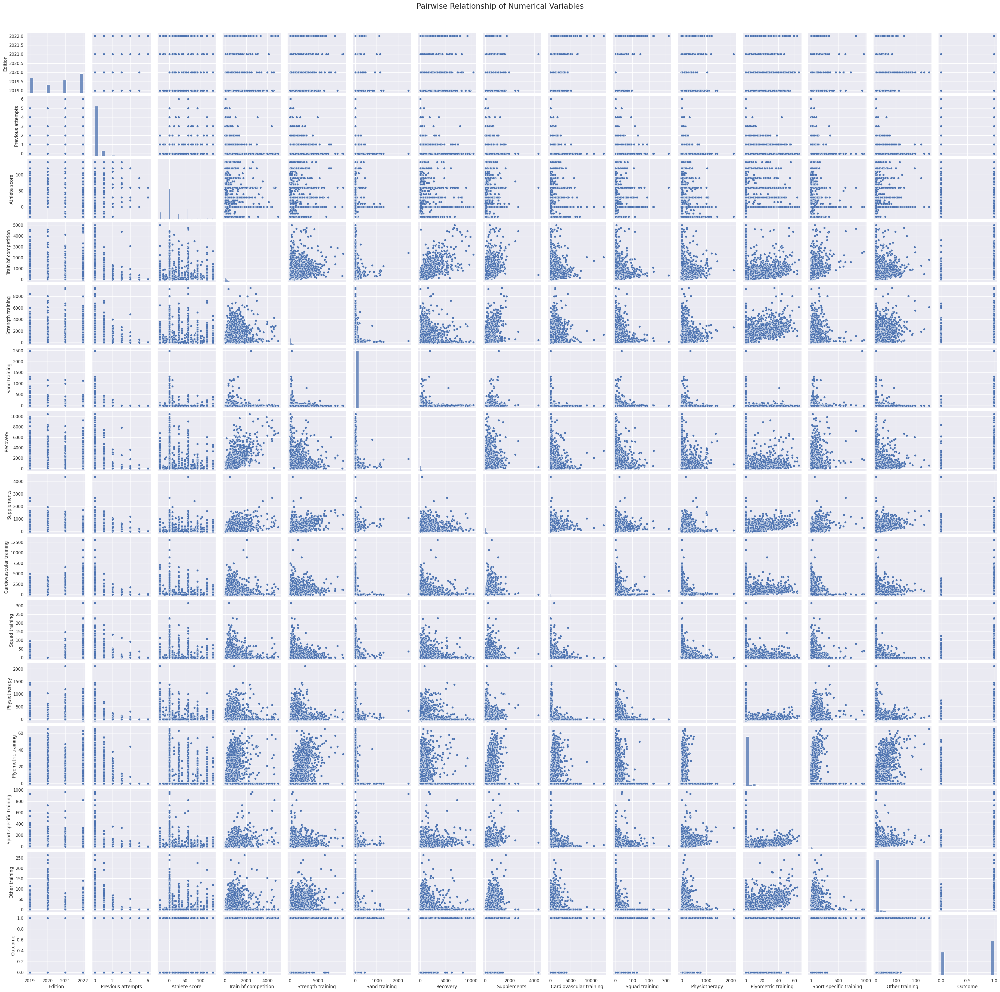

In [ ]:
# Pairwise Relationship of All Numerical Variables
sns.set()

# Setting pairplot
sns.pairplot(df_train[metric_features], diag_kind="hist")

# Layout
plt.subplots_adjust(top=0.95)
plt.suptitle("Pairwise Relationship of Numerical Variables", fontsize=20)

plt.show()

In [ ]:
from sklearn.feature_selection import f_classif
from sklearn.feature_selection import SelectKBest

# X is the matrix of features and y is the target variable
#X = df_train.loc[metric_features]
X = df_train[['Squad training', 'Athlete score']]
y = df_train['Outcome']

anova = SelectKBest(f_classif, k=5)
X_anova = anova.fit_transform(X, y)

selected_features = pd.Series(anova.get_support(), index = X.columns)
selected_features

ValueError: ignored

# Variáveis Categóricas

In [ ]:
## Descrição estatística descritiva - Categóricos
df_train.describe(include="object").T 

,count,unique,top,freq
Competition,17968,7,Local Match,4404
Sex,17962,2,M,9878
Region,17953,13,North America,2001
Education,17960,5,High school,8059
Age group,17952,4,0-35,12470
Income,17965,5,High,5395
Disability,17966,2,False,16298
Late enrollment,17969,2,False,17830
Cancelled enrollment,17967,2,False,14686
Mental preparation,17978,3,FALSE,16519


In [ ]:
## Número de eventos por variável categórica ('object')

for each in df_train.select_dtypes(include='object').columns:
  print(each)
  print(df_train[each].value_counts(dropna=False))
  print('')

Competition
Local Match                 4404
Regional Tournament         4225
Federation League           3417
National Cup                2373
Continental Championship    1597
World Championship          1454
Olympic Games                498
NaN                           87
Name: Competition, dtype: int64

Sex
M      9878
F      8084
NaN      93
Name: Sex, dtype: int64

Region
North America      2001
Western Europe     1855
East Asia          1767
South America      1689
Northern Africa    1495
Eastern Europe     1385
Middle East        1374
Central Asia       1275
Central America    1192
Oceania            1169
Southern Europe    1053
South Asia          993
Southern Africa     705
NaN                 102
Name: Region, dtype: int64

Education
High school          8059
Middle school        6755
University Degree    2807
Post Graduate         185
Elementary school     154
NaN                    95
Name: Education, dtype: int64

Age group
0-35     12470
35-55     5325
55<=       134
NaN

In [ ]:
# Profiling completo =)

profile = ProfileReport(
    df_train, 
    title='Profiling',
    correlations={
        "pearson": {"calculate": True},
        "spearman": {"calculate": True},
        "kendall": {"calculate": False},
        "phi_k": {"calculate": False},
        "cramers": {"calculate": False},
    },
)
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

# 3.Data Acess, Exploration and Understanding
## Tarefas
- [x] 'Mental preparation': Transformar TRUE, FALSE e FASE em booleano (assumimos que é um erro de escrita)
  - substitui FASE e FALSE para False e TRUE para True
- [x] 'Age group': missing values '0' no (construit modelo VS eliminar VS assumir mais frequente ('0-35')
  - assumi o mais frequente
- [ ] 'Competition', 'Região' e 'Education': com demasiadas opções - podemos testar juntar em dois ou três (nacional, internacional e mundial (world e olympic)) e fazer one hot encoding disso. Ou então talvez ver a correlção destas variaveis e de novas categorias com o target podem ajudar a decidir (tipo europa e america do norte ter maior correlação e juntamos os dois no mesmo e outros com resultados piores noutro conjunto)
- [ ] 'No coach': retirar a variável?? por ser uma nearly unary variables (nas aulas diz que devemos olhar para o target... antes de remover)
- [ ] lidar com quantidade elevada de missing values

No fim:
- [ ] transformar booleanos em 0 e 1 (?)



In [ ]:
# vou guardar o original como df_train e processar em df_train_processed
# Serve de RESET do processamento se algo correr mal
df_train_processed = df_train.copy()

# pipeline será uma lista de funções que farão parte do processamento
pipeline = []

In [ ]:
# substituir FASE e FALSE por False e TRUE por True (booleanos)

#função de processamento de gralhas no 'Mental preparation'
def substituicao_gralha_mental_preparation(df):
  # dicionário com antigo e novo parametro para substituit
  substitutes = {
    'FASE': False,
    'FALSE': False,
    'TRUE': True,
  }

  # substituição (obrigado ChatGPT)
  df['Mental preparation'] = df['Mental preparation'].apply(lambda x: substitutes.get(x, x))

  return df

# adicionar a nova função à pipeline
pipeline.append(substituicao_gralha_mental_preparation)

# testar a execução da função
substituicao_gralha_mental_preparation(df_train_processed)

# mostrar resultados antes e depois
print('ANTES')
print(df_train['Mental preparation'].value_counts())
print('')
print('DEPOIS')
print(df_train_processed['Mental preparation'].value_counts())


antes
FALSE    16519
TRUE      1360
FASE        99
Name: Mental preparation, dtype: int64

depois
False    16618
True      1360
Name: Mental preparation, dtype: int64


In [ ]:
# cálculo de frequencia do grupo nis frequente '0-35' e dos '0'

print('DISTRIBUIÇÃO DOS GRUPOS ETÁRIOS')
print(df_train['Age group'].value_counts())
print('')

print('PERCENTAGEM DE 0-35 E 0')
print(df_train[df_train_processed['Age group']=='0-35']['Age group'].value_counts() / df_train['Age group'].value_counts().sum())
print(df_train[df_train_processed['Age group']=='0']['Age group'].value_counts() / df_train['Age group'].value_counts().sum())

DISTRIBUIÇÃO DOS GRUPOS ETÁRIOS
0-35     12470
35-55     5325
55<=       134
0           23
Name: Age group, dtype: int64

PERCENTAGEM DE 0-35 E 0
0-35    0.694630
0       0.001281
Name: Age group, dtype: float64
Series([], Name: Age group, dtype: float64)


In [ ]:
# substituir '0' por '0-35' no Age group ('0-35' é o mais frequente - 69,4%)
# mas pode-se eliminar tmabém, pois corresponde a 0,13% dos dados

# pode-se  ponderar nova forma de abordar esse missing value

# processamento gravado em função
def substituicao_0_age_group(df):
  #dicionário com antigo e novo parametro para substituir
  substitutes = {
    '0': '0-35',
  }

  # substituição (obrigado ChatGPT)
  df['Age group'] = df['Age group'].apply(lambda x: substitutes.get(x, x))

  return df

# adicionar função de processamento à pipeline
pipeline.append(substituicao_0_age_group)

substituicao_0_age_group(df_train_processed)

print('ANTES')
print(df_train['Age group'].value_counts())
print('')
print('DEPOIS')
print(df_train_processed['Age group'].value_counts())

ANTES
0-35     12470
35-55     5325
55<=       134
0           23
Name: Age group, dtype: int64

DEPOIS
0-35     12493
35-55     5325
55<=       134
Name: Age group, dtype: int64


In [ ]:
# Transfomramr 'Sex' de 'F' e 'M' para 0 e 1

def substituicao_F_M_0_1_Sex(df):
  substitutes = {
    'F': 0,
    'M': 1,
  }

  df['Sex'] = df['Sex'].apply(lambda x: substitutes.get(x, x))

  return df

pipeline.append(substituicao_F_M_0_1_Sex)

substituicao_F_M_0_1_Sex(df_train_processed)
print('ANTES')
print(df_train['Sex'].value_counts())
print('')
print('DEPOIS')
print(df_train_processed['Sex'].value_counts())

# ficou float em vez de int...
# no fim não sem se tem impacto nos modelos

ANTES
M    9878
F    8084
Name: Sex, dtype: int64

DEPOIS
1.0    9878
0.0    8084
Name: Sex, dtype: int64


# Pipeline #>#>#># =)

In [ ]:
# execução de pipeline

# definição de na varável copia da original para poder aplicar o pipeline
df_train_pipeline_1 = df_train.copy()

# loop de execução das funções no pipeline
for func in pipeline:
  df_train_pipeline_1 = func(df_train_pipeline_1)

# mostrar novas contagens das variáveis categóricas 
for each in df_train_pipeline_1.select_dtypes(include='object').columns:
  print(each)
  print(df_train_pipeline_1[each].value_counts(dropna=False))
  print('')

<function substituicao_gralha_mental_preparation at 0x7f301093a310>
<function substituicao_0_age_group at 0x7f301093aa60>
<function substituicao_F_M_0_1_Sex at 0x7f301099f700>

Competition
Local Match                 4404
Regional Tournament         4225
Federation League           3417
National Cup                2373
Continental Championship    1597
World Championship          1454
Olympic Games                498
NaN                           87
Name: Competition, dtype: int64

Region
North America      2001
Western Europe     1855
East Asia          1767
South America      1689
Northern Africa    1495
Eastern Europe     1385
Middle East        1374
Central Asia       1275
Central America    1192
Oceania            1169
Southern Europe    1053
South Asia          993
Southern Africa     705
NaN                 102
Name: Region, dtype: int64

Education
High school          8059
Middle school        6755
University Degree    2807
Post Graduate         185
Elementary school     154
NaN

In [ ]:
# tentativa gira mas se calhar pouco legal para tentar diminuir espaço na 'Region'
# estava a tentar utilizar o chi quadrado como teste de independencia para variáveis 

"""
# Region
# vou usar o chi-quadrado para tentar entender que categorias terão mais correlação com o alvo de forma a agrupa-las

x_chi = df_train_processed['Region']
y_chi = df_train_processed['Outcome']

# create contingency table
contingency_table = pd.crosstab(x_chi, y_chi)

# perform chi-squared test
stat, p, dof, expected = chi2_contingency(contingency_table)

# plot heatmap
#sns.heatmap(contingency_table, annot=True, cmap='coolwarm')
#sns.heatmap(contingency_table, annot=True, cmap='coolwarm', fmt='d')

contingency_table['ratio'] = contingency_table.apply(lambda x: x[1] / (x[0]+x[1]), axis=1)

contingency_table.sort_values('ratio', ascending=False)"""


"\n# Region\n# vou usar o chi-quadrado para tentar entender que categorias terão mais correlação com o alvo de forma a agrupa-las\n\n\nx_chi = df_train_processed['Region']\ny_chi = df_train_processed['Outcome']\n\n# create contingency table\ncontingency_table = pd.crosstab(x_chi, y_chi)\n\n# perform chi-squared test\nstat, p, dof, expected = chi2_contingency(contingency_table)\n\n# plot heatmap\n#sns.heatmap(contingency_table, annot=True, cmap='coolwarm')\n#sns.heatmap(contingency_table, annot=True, cmap='coolwarm', fmt='d')\n\ncontingency_table['ratio'] = contingency_table.apply(lambda x: x[1] / (x[0]+x[1]), axis=1)\n\n\ncontingency_table.sort_values('ratio', ascending=False)"